Leave-one-group-out for the immune response prediction

In [1]:
import warnings
from anndata import ImplicitModificationWarning
warnings.filterwarnings("ignore", category=ImplicitModificationWarning)
warnings.filterwarnings("ignore")

In [2]:
import os,sys
sys.path.append(os.path.realpath(os.path.join(os.getcwd(), '..')))
import numpy as np
import scanpy as sc
import vqtcr as vq

In [3]:
path_base = '/mnt/d/Dataset/vqTCR/10xGenomics/'
path_data = path_base + 'avidity_esm.h5ad'

In [4]:
vq.set_random_seed(2025)
adata = sc.read_h5ad(path_data)
adata = adata[adata.obs['binding_name'].isin(vq.HIGH_COUNT_ANTIGENS)]
adata

View of AnnData object with n_obs × n_vars = 61096 × 5000
    obs: 'is_cell', 'high_confidence', 'multi_chain', 'extra_chains', 'IR_VJ_1_c_call', 'IR_VJ_2_c_call', 'IR_VDJ_1_c_call', 'IR_VDJ_2_c_call', 'IR_VJ_1_consensus_count', 'IR_VJ_2_consensus_count', 'IR_VDJ_1_consensus_count', 'IR_VDJ_2_consensus_count', 'IR_VJ_1_d_call', 'IR_VJ_2_d_call', 'IR_VDJ_1_d_call', 'IR_VDJ_2_d_call', 'IR_VJ_1_duplicate_count', 'IR_VJ_2_duplicate_count', 'IR_VDJ_1_duplicate_count', 'IR_VDJ_2_duplicate_count', 'IR_VJ_1_j_call', 'IR_VJ_2_j_call', 'IR_VDJ_1_j_call', 'IR_VDJ_2_j_call', 'IR_VJ_1_junction', 'IR_VJ_2_junction', 'IR_VDJ_1_junction', 'IR_VDJ_2_junction', 'IR_VJ_1_junction_aa', 'IR_VJ_2_junction_aa', 'IR_VDJ_1_junction_aa', 'IR_VDJ_2_junction_aa', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_productive', 'IR_VJ_2_productive', 'IR_VDJ_1_productive', 'IR_VDJ_2_productive', 'IR_VJ_1_v_call', 'IR_VJ_2_v_call', 'IR_VDJ_1_v_call', 'IR_VDJ_2_v_call', 'has_ir', 'barcode',

In [5]:
params = vq.get_pred_config(lr=1e-4, latent_dim=64, dropout=0.2, 
                            num_subspace=64, codewords_per_space=64)
params['epoch'] = 20
params['pred']['dim_latent'] = 2*64
params

{'dim_latent': 64,
 'batch_size': 512,
 'lr': 0.0001,
 'dropout': 0.2,
 'epoch': 20,
 'early': 10,
 'dataset': '',
 'save_path': '',
 'direction': 'max',
 'weight_decay': 0.0001,
 'loss_weight': [1.0, 1.0, 1.0, 1.0],
 'gex': {'dim_latent': 64, 'act': 'elu', 'norm': True},
 'tcr': {'esm_type': 'facebook/esm2_t6_8M_UR50D',
  'kmer_kernels': [1, 3, 5, 7],
  'dim_latent': 64,
  'dim_emb': 64,
  'num_heads': 8,
  'forward_expansion': 4,
  'dropout': 0.2,
  'num_encoder': 2,
  'num_decoder': 2,
  'mask_rate': 0.15,
  'beta_only': False,
  'esm_tokens': True},
 'fus': {'dim_latent': 64, 'dropout': 0.2, 'film_reg': 1.0},
 'pty': {'dim_latent': 128,
  'num_subspace': 64,
  'codewords_per_space': 64,
  'eps': 1e-05,
  'init_scale': 1.0,
  'ema_decay': 0.99,
  'commitment_beta': 0.25,
  'use_cosine': True,
  'dead_code_interval': 1000,
  'dead_code_threshold': 0.0001,
  'dead_code_topk': 16,
  'diversity_weight': 0.001},
 'pred': {'dim_latent': 128, 'dropout': 0.2, 'n_labels': 8}}

Leave one donor out(LoDonor) TCR-pMHC binding prediction

pretrain on all donors

Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t6_8M_UR50D and are newly initialized: ['esm.pooler.dense.bias', 'esm.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of EsmModel were not initialized from the model checkpoint at facebook/esm2_t6_8M_UR50D and are newly initialized: ['esm.pooler.dense.bias', 'esm.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


warmup codebook:   0%|          | 0/10 [00:00<?, ?it/s]

1.472695231437683 3.546380043029785 0.6809260845184326
1.281015157699585 3.487766742706299 0.6655604243278503
1.0998233556747437 3.454538583755493 0.6541275978088379
0.9316264390945435 3.4499969482421875 0.644219696521759
0.7938710451126099 3.439265727996826 0.6345335841178894
0.6816099286079407 3.421353578567505 0.6247962117195129
0.6003409624099731 3.4155921936035156 0.6156996488571167
0.5328773260116577 3.3942391872406006 0.606646716594696
0.48008692264556885 3.3687264919281006 0.5975104570388794
0.43737727403640747 3.3620314598083496 0.5886640548706055
0.4044763445854187 3.3476853370666504 0.5796509981155396
0.3744800090789795 3.3320541381835938 0.5708087086677551
0.35885360836982727 3.3293190002441406 0.5623623728752136
0.34035128355026245 3.3044490814208984 0.5536012053489685
0.3307301998138428 3.2949748039245605 0.54509037733078
0.3221978545188904 3.269589424133301 0.5364232063293457
0.3108955919742584 3.2569968700408936 0.5279636979103088
0.300750732421875 3.24613881111145 0.51

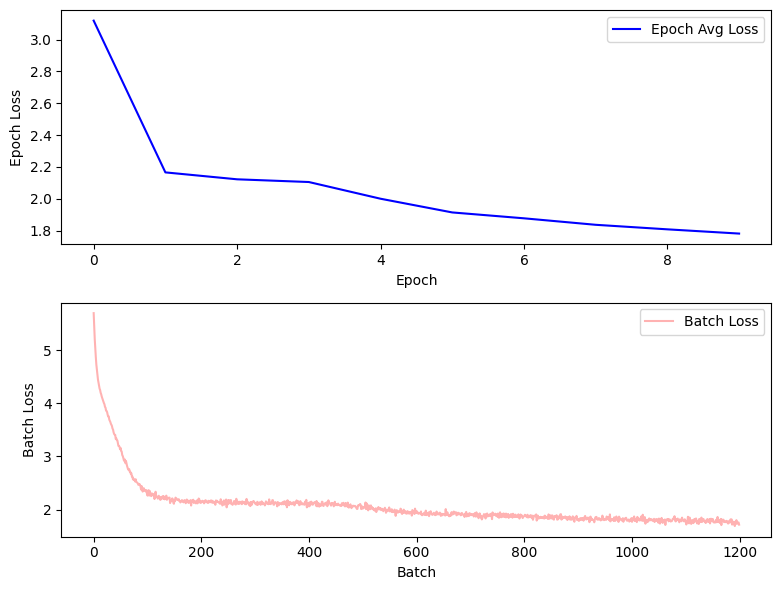

Sampling a subset of 16384 / 61096 for training
Clustering 16384 points in 2D to 64 clusters, redo 1 times, 20 iterations
  Preprocessing in 0.00 s
  Iteration 19 (0.01 s, search 0.01 s): objective=323.385 imbalance=1.077 nsplit=0       
Sampling a subset of 16384 / 61096 for training
Clustering 16384 points in 2D to 64 clusters, redo 1 times, 20 iterations
  Preprocessing in 0.00 s
  Iteration 19 (0.01 s, search 0.00 s): objective=274.002 imbalance=1.106 nsplit=0       
Sampling a subset of 16384 / 61096 for training
Clustering 16384 points in 2D to 64 clusters, redo 1 times, 20 iterations
  Preprocessing in 0.00 s
  Iteration 19 (0.01 s, search 0.00 s): objective=239.263 imbalance=1.104 nsplit=0       
Sampling a subset of 16384 / 61096 for training
Clustering 16384 points in 2D to 64 clusters, redo 1 times, 20 iterations
  Preprocessing in 0.00 s
  Iteration 19 (0.01 s, search 0.00 s): objective=228.656 imbalance=1.088 nsplit=0       
Sampling a subset of 16384 / 61096 for training


Pre-Training:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [54.43414306640625, 50.22677230834961, 52.548622131347656, 53.72088623046875, 49.350677490234375, 53.53615188598633, 51.545005798339844, 53.42425537109375, 52.098388671875, 52.12445831298828, 50.082000732421875, 51.36577224731445, 51.43672561645508, 54.71788024902344, 52.71563720703125, 51.49351501464844, 53.295265197753906, 53.41859436035156, 52.12165069580078, 52.60696029663086, 52.194854736328125, 50.166648864746094, 55.10149002075195, 52.324798583984375, 51.68312454223633, 53.94636535644531, 55.28173828125, 52.90015411376953, 53.669586181640625, 57.004974365234375, 52.36988067626953, 52.69434356689453, 50.48451614379883, 48.33357238769531, 52.2922477722168, 50.42405700683594, 52.06491470336914, 46.97840881347656, 50.029502868652344, 50.207950592041016, 50.004150390625, 43.098514556884766, 45.40857696533203, 53.42440414428711, 50.346981048583984, 48.009822845458984, 50.11285400390625, 50.578269958496094, 47.52967071533203, 52.943519592285156, 48.6638908386230

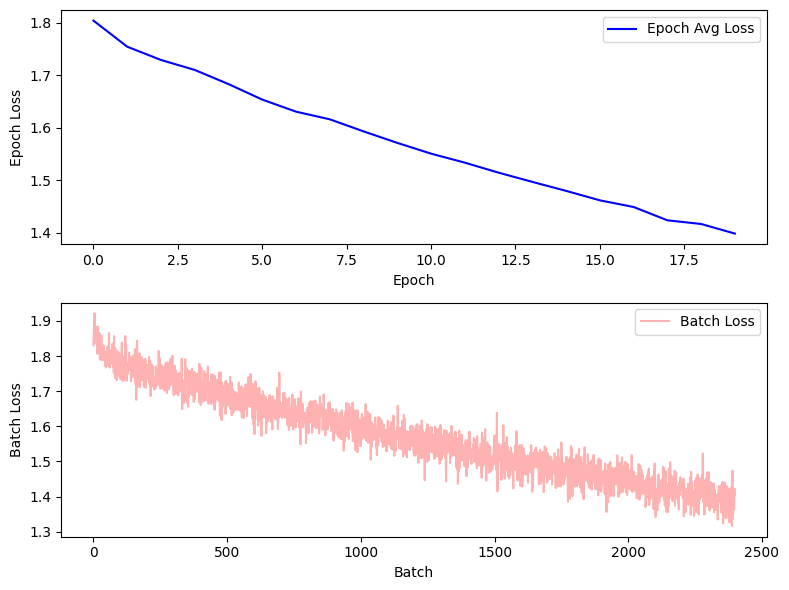

In [6]:
vqtcr = vq.vqTCR(params, adata, labels='binding_name')
vqtcr.pretrain(col_name='donor', 
               set_name=['donor_1', 'donor_2', 'donor_3', 'donor_4'],
               sample_mode='clonotype', 
               shuffle=False,
               labels=None,
               visual=True)

perplexity_per_codebook [19.840730667114258, 19.004667282104492, 22.6138858795166, 24.123523712158203, 19.651575088500977, 22.323999404907227, 23.333452224731445, 20.256935119628906, 20.847415924072266, 21.267719268798828, 22.12042999267578, 18.408281326293945, 24.002431869506836, 21.915098190307617, 19.581283569335938, 19.84244728088379, 23.278676986694336, 21.28019142150879, 20.70102882385254, 18.23671531677246, 19.816923141479492, 20.278507232666016, 22.802217483520508, 21.60011863708496, 19.466808319091797, 20.384742736816406, 20.446014404296875, 19.49121856689453, 21.017738342285156, 21.82570457458496, 22.515735626220703, 20.148963928222656, 11.537162780761719, 15.718205451965332, 15.630270004272461, 14.704166412353516, 22.222911834716797, 9.747575759887695, 12.339958190917969, 14.709081649780273, 20.23930549621582, 12.485620498657227, 18.677486419677734, 11.082162857055664, 18.64788246154785, 18.517671585083008, 20.594036102294922, 17.53675651550293, 14.224959373474121, 18.653633

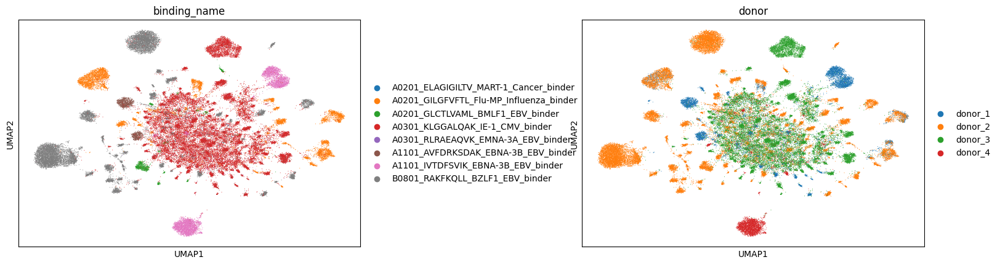

In [7]:
adata = vqtcr.get_latent(adata, col_name='donor', set_name=['donor_1', 'donor_2', 'donor_3', 'donor_4'])
# tcr latent space
sc.pp.neighbors(adata, use_rep='htcell')
sc.tl.umap(adata)
sc.pl.umap(adata, color=['binding_name', 'donor'], wspace=0.5)

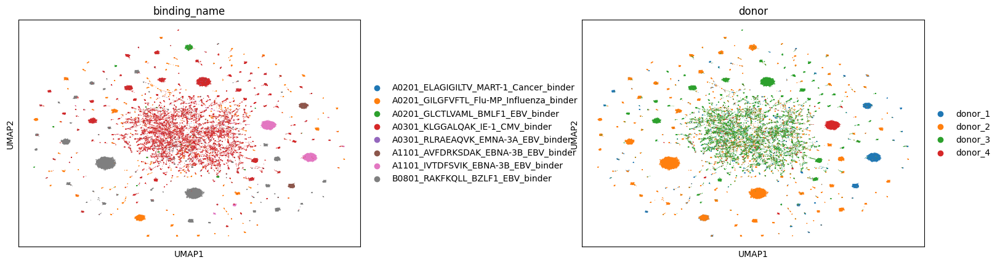

In [8]:
# tcr latent space
sc.pp.neighbors(adata, use_rep='htcr')
sc.tl.umap(adata)
sc.pl.umap(adata, color=['binding_name', 'donor'], wspace=0.5)

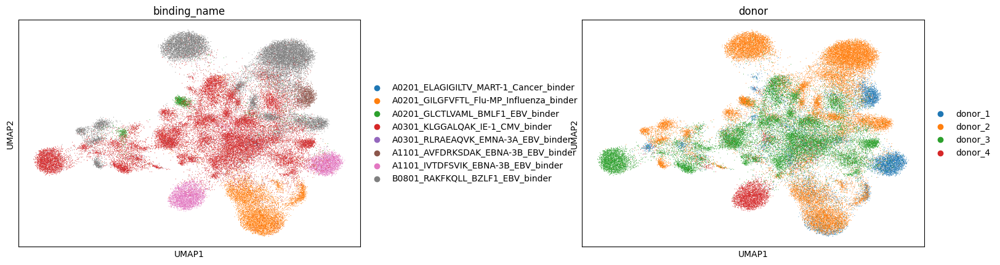

In [9]:
# gex residual latent space
sc.pp.neighbors(adata, use_rep='hgex')
sc.tl.umap(adata)
sc.pl.umap(adata, color=['binding_name', 'donor'], wspace=0.5)

prediction training on remianing patients and test on leave-out patient

In [10]:
# test_score = vqtcr.compute_metrics(metrics='knn_prediction', eval_set='test')
record = {}
adata = vqtcr.get_latent(adata,col_name='donor', set_name=['donor_1', 'donor_2', 'donor_3', 'donor_4'])
adata_train = adata[adata.obs['set'].isin(['train', 'valid'])]
adata_valid = adata[adata.obs['set']=='test']

knn_scores = vq.get_knn_cls(adata_train.obsm['htcr'], adata_valid.obsm['htcr'],
                            adata_train.obs['binding_name'], 
                            adata_valid.obs['binding_name'])
record['knn_prediction'] = knn_scores['weighted avg']['f1-score']
record['knn_prediction']

perplexity_per_codebook [19.840730667114258, 19.004667282104492, 22.6138858795166, 24.123523712158203, 19.651575088500977, 22.323999404907227, 23.333452224731445, 20.256935119628906, 20.847415924072266, 21.267719268798828, 22.12042999267578, 18.408281326293945, 24.002431869506836, 21.915098190307617, 19.581283569335938, 19.84244728088379, 23.278676986694336, 21.28019142150879, 20.70102882385254, 18.23671531677246, 19.816923141479492, 20.278507232666016, 22.802217483520508, 21.60011863708496, 19.466808319091797, 20.384742736816406, 20.446014404296875, 19.49121856689453, 21.017738342285156, 21.82570457458496, 22.515735626220703, 20.148963928222656, 11.537162780761719, 15.718205451965332, 15.630270004272461, 14.704166412353516, 22.222911834716797, 9.747575759887695, 12.339958190917969, 14.709081649780273, 20.23930549621582, 12.485620498657227, 18.677486419677734, 11.082162857055664, 18.64788246154785, 18.517671585083008, 20.594036102294922, 17.53675651550293, 14.224959373474121, 18.653633

0.46741973080702054

In [11]:
adata = vq.split_adata(adata, split_col='clonotype', random_seed=2025)
record = {}
adata = vqtcr.get_latent(adata, col_name='donor', set_name=['donor_1', 'donor_2', 'donor_3', 'donor_4'])
adata_train = adata[adata.obs['set']=='train']
adata_valid = adata[adata.obs['set']=='test']

knn_scores = vq.get_knn_cls(adata_train.obsm['htcr'], adata_valid.obsm['htcr'],
                            adata_train.obs['binding_name'], 
                            adata_valid.obs['binding_name'])
record['knn_prediction'] = knn_scores['weighted avg']['f1-score']
record['knn_prediction']

perplexity_per_codebook [19.840730667114258, 19.004667282104492, 22.6138858795166, 24.123523712158203, 19.651575088500977, 22.323999404907227, 23.333452224731445, 20.256935119628906, 20.847415924072266, 21.267719268798828, 22.12042999267578, 18.408281326293945, 24.002431869506836, 21.915098190307617, 19.581283569335938, 19.84244728088379, 23.278676986694336, 21.28019142150879, 20.70102882385254, 18.23671531677246, 19.816923141479492, 20.278507232666016, 22.802217483520508, 21.60011863708496, 19.466808319091797, 20.384742736816406, 20.446014404296875, 19.49121856689453, 21.017738342285156, 21.82570457458496, 22.515735626220703, 20.148963928222656, 11.537162780761719, 15.718205451965332, 15.630270004272461, 14.704166412353516, 22.222911834716797, 9.747575759887695, 12.339958190917969, 14.709081649780273, 20.23930549621582, 12.485620498657227, 18.677486419677734, 11.082162857055664, 18.64788246154785, 18.517671585083008, 20.594036102294922, 17.53675651550293, 14.224959373474121, 18.653633

0.7821657989810129

In [12]:
from sklearn.model_selection import LeaveOneGroupOut, LeavePGroupsOut
logo = LeaveOneGroupOut()
all_test_metrics = []
donor_ids = adata.obs.donor.to_numpy()
import numpy as np
for train_valid_idx, test_idx in logo.split(X=adata.X, groups=donor_ids):
    test_donor = donor_ids[test_idx][0]
    print(f"\n=== test on {test_donor} ===")
    adata.obs.loc[adata.obs.index[train_valid_idx], 'set']='train'
    adata.obs.loc[adata.obs.index[test_idx], 'set'] = 'test'
    record = {}
    adata = vqtcr.get_latent(adata, col_name='donor', set_name=['donor_1', 'donor_2', 'donor_3', 'donor_4'])
    adata_train = adata[adata.obs['set']=='train']
    adata_valid = adata[adata.obs['set']=='test']

    knn_scores = vq.get_knn_cls(adata_train.obsm['htcr'], adata_valid.obsm['htcr'],
                                adata_train.obs['binding_name'], 
                                adata_valid.obs['binding_name'])
    record['knn_prediction'] = knn_scores['weighted avg']['f1-score']
    print(record['knn_prediction'])


=== test on donor_1 ===
perplexity_per_codebook [19.840730667114258, 19.004667282104492, 22.6138858795166, 24.123523712158203, 19.651575088500977, 22.323999404907227, 23.333452224731445, 20.256935119628906, 20.847415924072266, 21.267719268798828, 22.12042999267578, 18.408281326293945, 24.002431869506836, 21.915098190307617, 19.581283569335938, 19.84244728088379, 23.278676986694336, 21.28019142150879, 20.70102882385254, 18.23671531677246, 19.816923141479492, 20.278507232666016, 22.802217483520508, 21.60011863708496, 19.466808319091797, 20.384742736816406, 20.446014404296875, 19.49121856689453, 21.017738342285156, 21.82570457458496, 22.515735626220703, 20.148963928222656, 11.537162780761719, 15.718205451965332, 15.630270004272461, 14.704166412353516, 22.222911834716797, 9.747575759887695, 12.339958190917969, 14.709081649780273, 20.23930549621582, 12.485620498657227, 18.677486419677734, 11.082162857055664, 18.64788246154785, 18.517671585083008, 20.594036102294922, 17.53675651550293, 14.2

In [13]:
all_test_metrics = []
for train_valid_idx, test_idx in logo.split(X=adata.X, groups=donor_ids):
    test_donor = donor_ids[test_idx][0]
    print(f"\n=== test on {test_donor} ===")
    # split train-valid dataset
    adata_train_val = adata[train_valid_idx]
    train, val = vq.split_dataset(adata_train_val, split_ratio=0.25, 
                                  split_col='clonotype', random_seed=2025)
    adata.obs['set'] = None
    adata.obs.loc[train.obs.index, 'set'] = 'train'
    adata.obs.loc[val.obs.index, 'set'] = 'valid'
    adata.obs.loc[adata.obs.index[test_idx], 'set'] = 'test'
    trainloader = vq.get_dataloader(adata=adata, 
                                     batch_size=params['batch_size'],
                                     col_name='set',
                                     set_name=['train'],
                                     sample_mode='clonotype',
                                     shuffle=False, 
                                     labels='binding_name')
    validloader = vq.get_dataloader(adata=adata, 
                                     batch_size=params['batch_size'],
                                     col_name='set',
                                     set_name=['valid'],
                                     sample_mode=None,
                                     shuffle=False, 
                                     labels='binding_name')
    testloader = vq.get_dataloader(adata=adata, 
                                     batch_size=params['batch_size'],
                                     col_name='set',
                                     set_name=['test'],
                                     sample_mode=None,
                                     shuffle=False, 
                                     labels='binding_name')
    best_score = vqtcr.predict_train(trainloader, validloader)
    print(f'best score in validation: {best_score}')
    
    test_metrics = vqtcr.predict_test(testloader)
    all_test_metrics.append(test_metrics)
    
metric = 'weighted'
print("\n" + "="*60)
print("LOGO Results:")
for i, metrics in enumerate(all_test_metrics):
        print(f"Donor {np.unique(donor_ids)[i]}: "
              f"f1: {metrics[f'f1_{metric}']:.3f}, "
              f"AUC-ROC: {metrics[f'auc_roc_{metric}']:.3f}, "
              f"AUC-PR: {metrics[f'auc_pr_{metric}']:.3f}")
    
mean_f1 = np.nanmean([m[f'f1_{metric}'] for m in all_test_metrics])
mean_auc_roc = np.nanmean([m[f'auc_roc_{metric}'] for m in all_test_metrics])
mean_auc_pr = np.nanmean([m[f'auc_pr_{metric}'] for m in all_test_metrics])

print(f"\n Average: "
        f"fa: {mean_f1:.3f} ± {np.nanstd([m[f'f1_{metric}'] for m in all_test_metrics]):.3f}, "
        f"AUC-ROC: {mean_auc_roc:.3f} ± {np.nanstd([m[f'auc_roc_{metric}'] for m in all_test_metrics]):.3f}, "
        f"AUC-PR: {mean_auc_pr:.3f} ± {np.nanstd([m[f'auc_pr_{metric}'] for m in all_test_metrics]):.3f}")


=== test on donor_1 ===


Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [44.9272346496582, 41.94779586791992, 56.98252868652344, 57.95130920410156, 53.743431091308594, 44.64025115966797, 58.5418701171875, 55.61423873901367, 54.60468292236328, 53.03535461425781, 51.20637130737305, 45.44039535522461, 54.49049758911133, 54.77855682373047, 52.015708923339844, 46.86383056640625, 58.71936798095703, 55.17623519897461, 34.33919906616211, 51.39994812011719, 47.42348098754883, 44.682586669921875, 57.98074722290039, 55.73673629760742, 53.220794677734375, 53.421783447265625, 56.17586135864258, 50.608421325683594, 50.81185531616211, 48.49793243408203, 52.796932220458984, 50.12179183959961, 12.62116527557373, 16.957197189331055, 22.296968460083008, 14.882305145263672, 20.635204315185547, 13.420608520507812, 12.456873893737793, 18.545459747314453, 20.3889217376709, 18.7572078704834, 14.517163276672363, 15.506718635559082, 15.797104835510254, 15.346199035644531, 13.877092361450195, 15.786810874938965, 14.520930290222168, 15.832340240478516, 19.0748

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [47.785274505615234, 40.81675338745117, 57.291648864746094, 58.651954650878906, 55.070098876953125, 46.184730529785156, 58.922237396240234, 55.416282653808594, 52.310115814208984, 53.17644119262695, 52.93407440185547, 46.53852844238281, 52.43184280395508, 55.706974029541016, 52.65839767456055, 43.532833099365234, 59.8393440246582, 56.10225296020508, 35.33689498901367, 51.64786911010742, 48.05937576293945, 43.98023223876953, 57.23468780517578, 55.76041793823242, 55.884063720703125, 56.63346481323242, 56.75815200805664, 50.80282974243164, 49.06899642944336, 51.152584075927734, 55.92988967895508, 49.8149528503418, 13.103302001953125, 18.70177459716797, 22.644994735717773, 15.426743507385254, 19.061689376831055, 13.231913566589355, 11.166074752807617, 16.217073440551758, 19.38490104675293, 17.34688949584961, 12.493874549865723, 17.175630569458008, 18.293121337890625, 15.585867881774902, 13.082525253295898, 15.192890167236328, 15.121630668640137, 16.05837631225586, 1

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [47.31898880004883, 41.46821212768555, 55.88352584838867, 56.231712341308594, 53.254249572753906, 45.86845397949219, 54.41858673095703, 52.9715461730957, 50.800567626953125, 51.22115707397461, 52.500267028808594, 42.53696060180664, 55.2725944519043, 52.801753997802734, 51.93555450439453, 48.164710998535156, 55.21271896362305, 50.212440490722656, 41.15131378173828, 46.28122329711914, 45.136165618896484, 50.41976547241211, 52.99994659423828, 50.24949645996094, 50.10568618774414, 53.6392707824707, 57.225547790527344, 47.02479934692383, 47.923614501953125, 45.8183708190918, 49.96233367919922, 47.06342697143555, 12.311441421508789, 16.74358367919922, 14.996053695678711, 14.047070503234863, 19.07638168334961, 12.659239768981934, 14.00972843170166, 16.461368560791016, 23.858774185180664, 16.45635986328125, 14.433850288391113, 11.756278991699219, 15.688579559326172, 16.04911231994629, 18.24285125732422, 14.142739295959473, 15.093283653259277, 14.473908424377441, 12.8313

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [46.923580169677734, 38.98976135253906, 56.53956604003906, 59.475791931152344, 54.302772521972656, 44.70418930053711, 56.72968292236328, 55.42976760864258, 53.684085845947266, 52.35910415649414, 51.879615783691406, 46.16493606567383, 53.756324768066406, 56.092994689941406, 52.90126419067383, 48.15888214111328, 57.90742111206055, 55.855342864990234, 35.02615737915039, 48.71926498413086, 48.59938049316406, 45.7351188659668, 57.73097229003906, 56.9580192565918, 52.66915512084961, 53.93965530395508, 57.029170989990234, 49.75069046020508, 49.86956787109375, 49.29212951660156, 53.684471130371094, 49.62443542480469, 13.745917320251465, 17.422414779663086, 19.784381866455078, 14.95215892791748, 20.05452537536621, 11.215483665466309, 13.22925853729248, 17.98118782043457, 18.75249671936035, 17.60085678100586, 14.204587936401367, 15.432284355163574, 16.786706924438477, 15.809541702270508, 15.779330253601074, 15.365720748901367, 15.379876136779785, 15.84998893737793, 16.611

In [14]:
all_test_metrics = []
for i in range(5):
    adata = vq.split_adata(adata, split_col='clonotype', random_seed=i)
    trainloader = vq.get_dataloader(adata=adata, 
                                     batch_size=params['batch_size'],
                                     col_name='set',
                                     set_name=['train'],
                                     sample_mode='clonotype',
                                     shuffle=False, 
                                     labels='binding_name')
    validloader = vq.get_dataloader(adata=adata, 
                                     batch_size=params['batch_size'],
                                     col_name='set',
                                     set_name=['valid'],
                                     sample_mode=None,
                                     shuffle=False, 
                                     labels='binding_name')
    testloader = vq.get_dataloader(adata=adata,
                                     batch_size=params['batch_size'],
                                     col_name='set',
                                     set_name=['test'],
                                     sample_mode=None,
                                     shuffle=False,
                                     labels='binding_name')
    best_score = vqtcr.predict_train(trainloader, validloader)
    print(f'best score in validation: {best_score}')
    
    test_metrics = vqtcr.predict_test(testloader)
    all_test_metrics.append(test_metrics)

print("\n" + "="*60)
print("LOGO Results:")
for i, metrics in enumerate(all_test_metrics):
        print(f"splite {i}: "
              f"F1: {metrics[f'f1_{metric}']:.3f}, "
              f"AUC-ROC: {metrics[f'auc_roc_{metric}']:.3f}, "
              f"AUC-PR: {metrics[f'auc_pr_{metric}']:.3f}")
    
mean_f1 = np.nanmean([m[f'f1_{metric}'] for m in all_test_metrics])
mean_auc_roc = np.nanmean([m[f'auc_roc_{metric}'] for m in all_test_metrics])
mean_auc_pr = np.nanmean([m[f'auc_pr_{metric}'] for m in all_test_metrics])

print(f"\n Average: "
        f"F1: {mean_f1:.3f} ± {np.nanstd([m[f'f1_{metric}'] for m in all_test_metrics]):.3f}, "
        f"AUC-ROC: {mean_auc_roc:.3f} ± {np.nanstd([m[f'auc_roc_{metric}'] for m in all_test_metrics]):.3f}, "
        f"AUC-PR: {mean_auc_pr:.3f} ± {np.nanstd([m[f'auc_pr_{metric}'] for m in all_test_metrics]):.3f}")

    

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [48.084049224853516, 40.30673599243164, 55.62211608886719, 57.534915924072266, 54.16672897338867, 43.94586181640625, 58.369468688964844, 57.8765869140625, 54.81338119506836, 50.30481719970703, 51.35674285888672, 43.63467788696289, 53.052452087402344, 54.39976501464844, 52.45315170288086, 46.65586853027344, 57.977264404296875, 53.17976379394531, 34.21574783325195, 54.080055236816406, 46.049766540527344, 46.35629653930664, 58.878173828125, 54.90774154663086, 54.52941131591797, 55.00446319580078, 58.05876922607422, 49.460296630859375, 50.69427490234375, 47.67208480834961, 51.978912353515625, 49.22937774658203, 13.63417911529541, 19.090145111083984, 21.30146598815918, 16.20132064819336, 19.738426208496094, 13.070974349975586, 12.987805366516113, 18.55832862854004, 19.69695281982422, 17.080480575561523, 14.411320686340332, 14.94370174407959, 16.81521987915039, 16.864439010620117, 15.789224624633789, 14.679181098937988, 15.413836479187012, 15.825034141540527, 17.88113

perplexity_per_codebook [49.61527633666992, 41.26761245727539, 57.93064498901367, 58.796531677246094, 52.80239486694336, 43.50288009643555, 58.29734420776367, 55.31129455566406, 54.471092224121094, 53.264320373535156, 52.620418548583984, 43.4676399230957, 53.96128845214844, 55.01970291137695, 52.019649505615234, 46.766746520996094, 59.6844367980957, 54.4476432800293, 37.5079231262207, 49.44233703613281, 49.76521301269531, 47.75649642944336, 58.685916900634766, 54.97795486450195, 55.0160026550293, 55.972442626953125, 58.213035583496094, 48.62457275390625, 50.25312423706055, 48.7275276184082, 52.68680191040039, 50.74834060668945, 12.99668025970459, 18.61150550842285, 19.94879150390625, 15.75727653503418, 18.467092514038086, 12.780370712280273, 12.332805633544922, 19.572786331176758, 21.24345588684082, 16.620643615722656, 14.485279083251953, 15.692822456359863, 16.48285484313965, 17.384084701538086, 13.892005920410156, 16.435333251953125, 15.567194938659668, 13.954536437988281, 17.2958812

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [49.11780548095703, 41.914424896240234, 58.63182067871094, 59.90306091308594, 55.87137985229492, 47.38905334472656, 57.71379470825195, 54.24238204956055, 53.860145568847656, 52.33475112915039, 53.6352424621582, 42.84227752685547, 54.59046936035156, 54.849910736083984, 51.419830322265625, 49.3205680847168, 57.91385269165039, 54.51206970214844, 40.157630920410156, 49.8608283996582, 45.88873291015625, 46.72900390625, 56.53999710083008, 54.266868591308594, 52.93803024291992, 57.104984283447266, 58.69647216796875, 50.92506790161133, 48.29499435424805, 49.14248275756836, 55.45585632324219, 48.974544525146484, 14.261706352233887, 16.652177810668945, 18.48760986328125, 14.479244232177734, 18.788158416748047, 12.106499671936035, 12.556424140930176, 18.785228729248047, 20.773681640625, 15.861465454101562, 14.504783630371094, 15.909186363220215, 16.29964256286621, 15.78108024597168, 15.1346435546875, 15.112256050109863, 15.7481050491333, 16.296802520751953, 18.930274963378

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [47.55325698852539, 42.84768295288086, 56.382713317871094, 58.2357177734375, 55.7032585144043, 48.33190155029297, 57.7392578125, 55.180686950683594, 54.013519287109375, 53.41368103027344, 55.2270393371582, 45.31129837036133, 53.933712005615234, 56.7919921875, 51.376502990722656, 47.35007858276367, 57.17347717285156, 55.90426254272461, 38.52055358886719, 48.58835983276367, 46.34325408935547, 46.13227081298828, 57.2115478515625, 55.949974060058594, 52.780242919921875, 56.24188232421875, 55.827781677246094, 51.589115142822266, 47.649471282958984, 47.44438171386719, 52.504974365234375, 49.620574951171875, 11.931326866149902, 16.579553604125977, 18.809650421142578, 15.848564147949219, 18.810222625732422, 14.316670417785645, 13.26457691192627, 17.238065719604492, 21.98481559753418, 16.50274658203125, 15.655085563659668, 15.877198219299316, 18.167133331298828, 15.552838325500488, 14.348737716674805, 13.727736473083496, 14.35360336303711, 15.61494255065918, 17.150604248

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [48.75019454956055, 41.48130416870117, 57.884117126464844, 59.4299201965332, 53.104740142822266, 44.52534866333008, 58.06629943847656, 55.64824676513672, 53.08702087402344, 50.05245590209961, 52.492408752441406, 45.86505126953125, 55.571929931640625, 53.257930755615234, 47.994300842285156, 50.467498779296875, 56.543800354003906, 53.28767776489258, 38.97291946411133, 48.1435432434082, 48.2047119140625, 48.78211975097656, 56.474143981933594, 54.61918640136719, 53.74835205078125, 54.408790588378906, 56.12678527832031, 53.358009338378906, 48.745849609375, 49.76158142089844, 52.531883239746094, 50.034324645996094, 13.265475273132324, 18.218414306640625, 19.05208396911621, 16.557157516479492, 19.114633560180664, 13.131245613098145, 12.940387725830078, 19.80467414855957, 19.848812103271484, 16.30962562561035, 14.360624313354492, 15.064563751220703, 17.88208770751953, 15.660293579101562, 14.31134033203125, 15.207364082336426, 15.771736145019531, 15.729470252990723, 17.5

Training prediction head:   0%|          | 0/20 [00:00<?, ?it/s]

perplexity_per_codebook [47.161319732666016, 40.87946319580078, 57.3128776550293, 58.23474884033203, 52.945762634277344, 47.213462829589844, 58.51061248779297, 54.41180419921875, 53.154319763183594, 51.01476287841797, 52.96024703979492, 43.11762237548828, 53.76114273071289, 55.6235237121582, 51.586090087890625, 48.67317199707031, 56.843685150146484, 54.86910629272461, 38.55172348022461, 47.12857437133789, 48.3748893737793, 44.89836502075195, 55.452789306640625, 55.57619857788086, 52.20686340332031, 53.64140701293945, 55.26789855957031, 49.32978820800781, 47.01152801513672, 47.633548736572266, 52.082454681396484, 47.422386169433594, 11.939528465270996, 17.86741065979004, 19.21246337890625, 16.55455207824707, 18.628660202026367, 13.174966812133789, 12.794903755187988, 17.782934188842773, 17.847932815551758, 16.85511016845703, 15.294930458068848, 16.296234130859375, 18.125673294067383, 16.00913429260254, 14.319541931152344, 13.225088119506836, 14.90455436706543, 14.759753227233887, 18.009